In [2]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [31]:
import os

folder_path = "/content/drive/My Drive/Dataset"  # Change this to your folder path

num_files = sum(len(files) for _, _, files in os.walk(folder_path))
num_folders = sum(len(dirs) for _, dirs, _ in os.walk(folder_path))

print(f"Number of files: {num_files}")
print(f"Number of folders: {num_folders}")


Number of files: 136
Number of folders: 17


## Diplaying the images in the folder

In [30]:
import os
import cv2
import matplotlib.pyplot as plt

# Check if the main folder exists
if not os.path.exists(folder_path):
    print(f"Error: The folder '{folder_path}' does not exist. Check the path.")
else:
    # List all subfolders inside the main folder
    subfolders = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, f))]

    # Check if subfolders exist
    if not subfolders:
        print("No subfolders found.")
    else:
        for folder in subfolders:
            folder_name = os.path.basename(folder)  # Extract folder name
            print(f"Displaying images from folder: {folder_name}")

            # Get all images in the folder
            image_files = [os.path.join(folder, f) for f in os.listdir(folder) if f.lower().endswith(('png', 'jpg', 'jpeg'))]

            if not image_files:
                print(f"No images found in {folder_name}.")
                continue

            # Set grid size for the folder
            num_images = len(image_files)
            cols = 5  # Number of columns
            rows = (num_images // cols) + (1 if num_images % cols else 0)  # Calculate rows needed

            # Create figure
            fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
            fig.suptitle(f"Folder: {folder_name}", fontsize=16, fontweight="bold")  # Add folder name as title

            # Convert axes to a 2D list if there's only one row
            if rows == 1:
                axes = [axes] if cols > 1 else [[axes]]

            i = 0
            for i, img_path in enumerate(image_files):
                image = cv2.imread(img_path)

                if image is None:
                    print(f"Error loading image: {img_path}")
                    continue

                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

                # Get subplot position safely
                row_idx = i // cols
                col_idx = i % cols

                ax = axes[row_idx][col_idx] if rows > 1 else axes[0][col_idx]  # Ensure indexing is always valid

                ax.imshow(image)
                ax.axis('off')
                ax.set_title(os.path.basename(img_path)[:20])  # Show part of filename

            # Hide empty subplots
            for j in range(i + 1, rows * cols):
                row_idx = j // cols
                col_idx = j % cols
                if rows > 1:
                    fig.delaxes(axes[row_idx][col_idx])
                else:
                    fig.delaxes(axes[0][col_idx])

            plt.tight_layout()
            plt.show()


Error: The folder 'your_main_folder_path' does not exist. Check the path.


If images are not in 4:5 ratio then we convert then to the same


Displaying images from folder: 2M_3


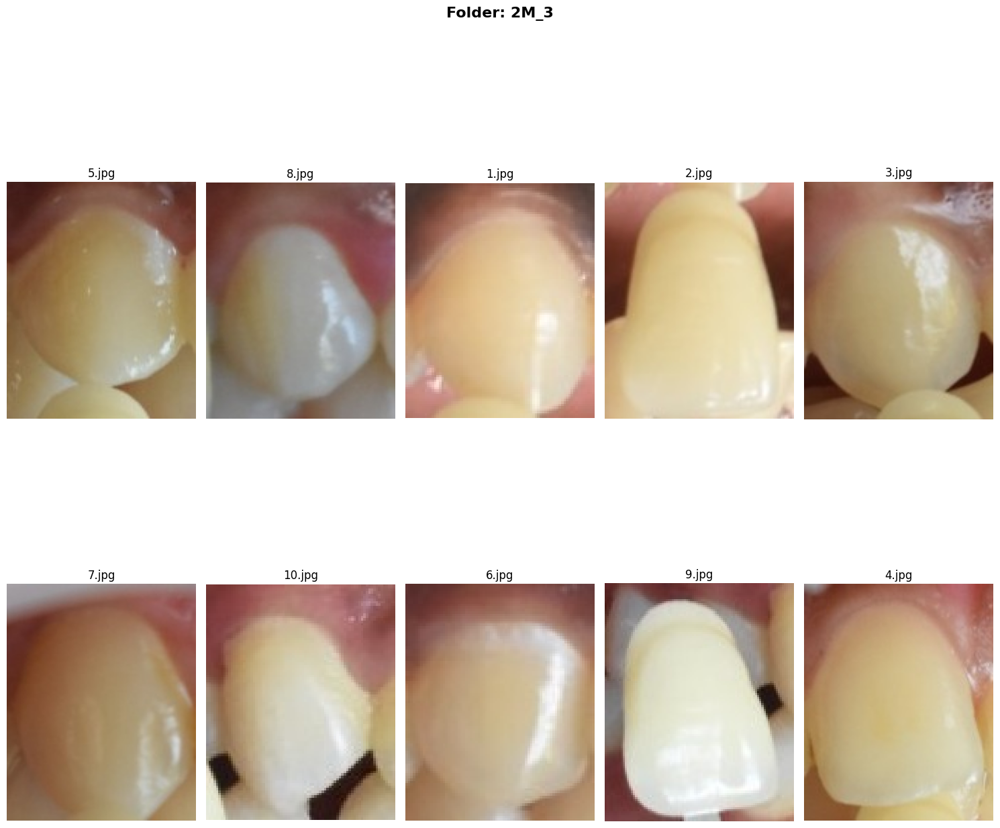

Displaying images from folder: 2M_2


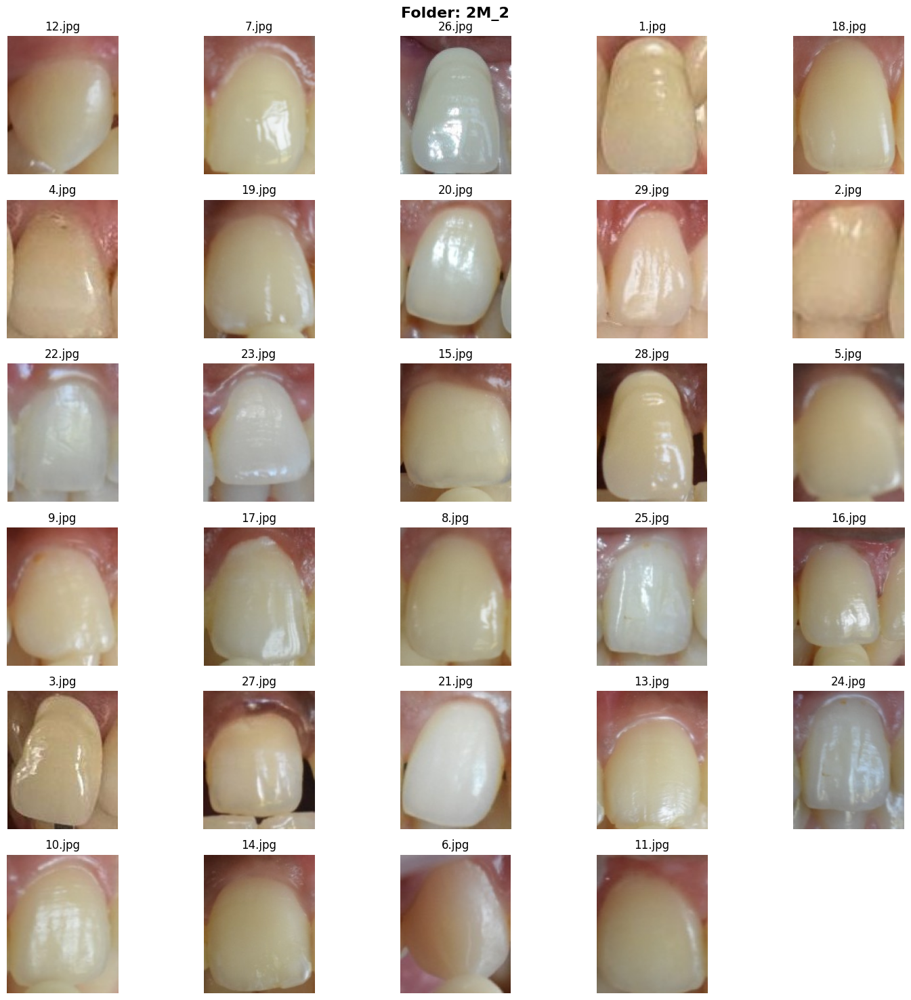

Displaying images from folder: 3R_2.5


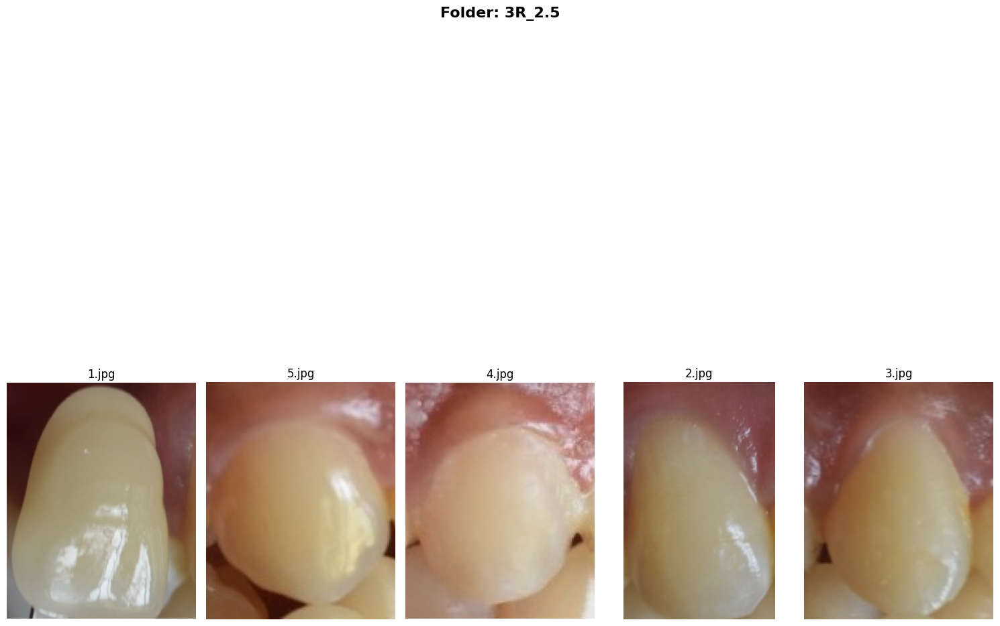

Displaying images from folder: 3L_2.5


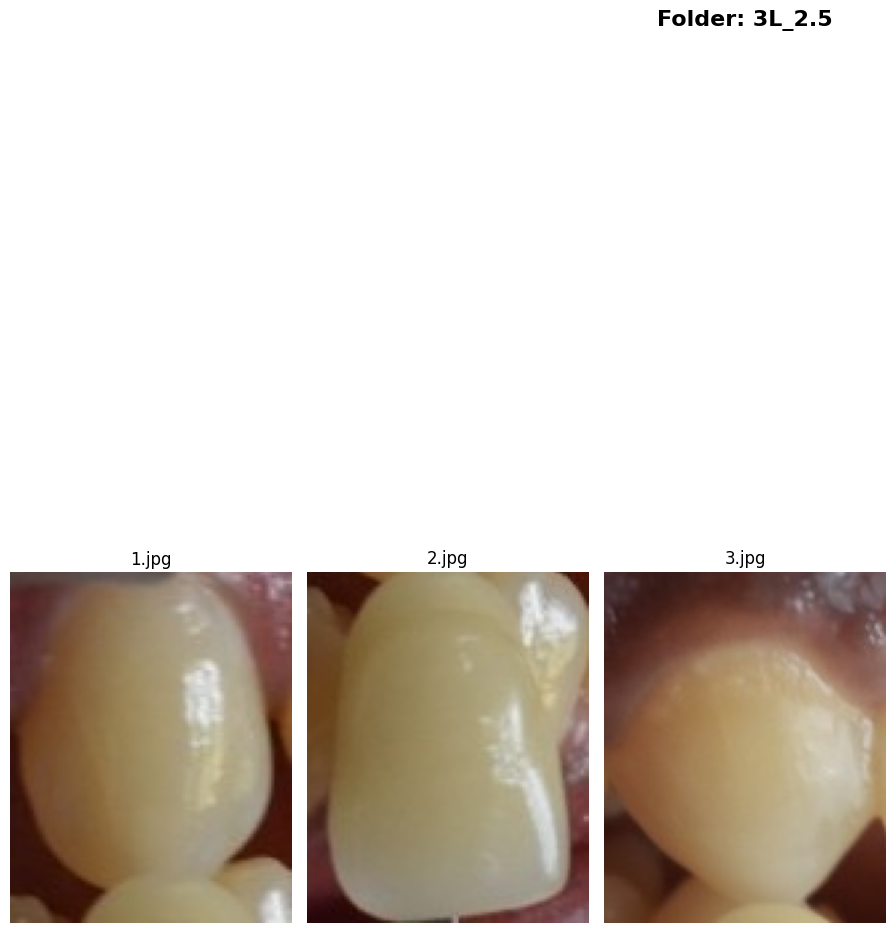

Displaying images from folder: 3L_1.5


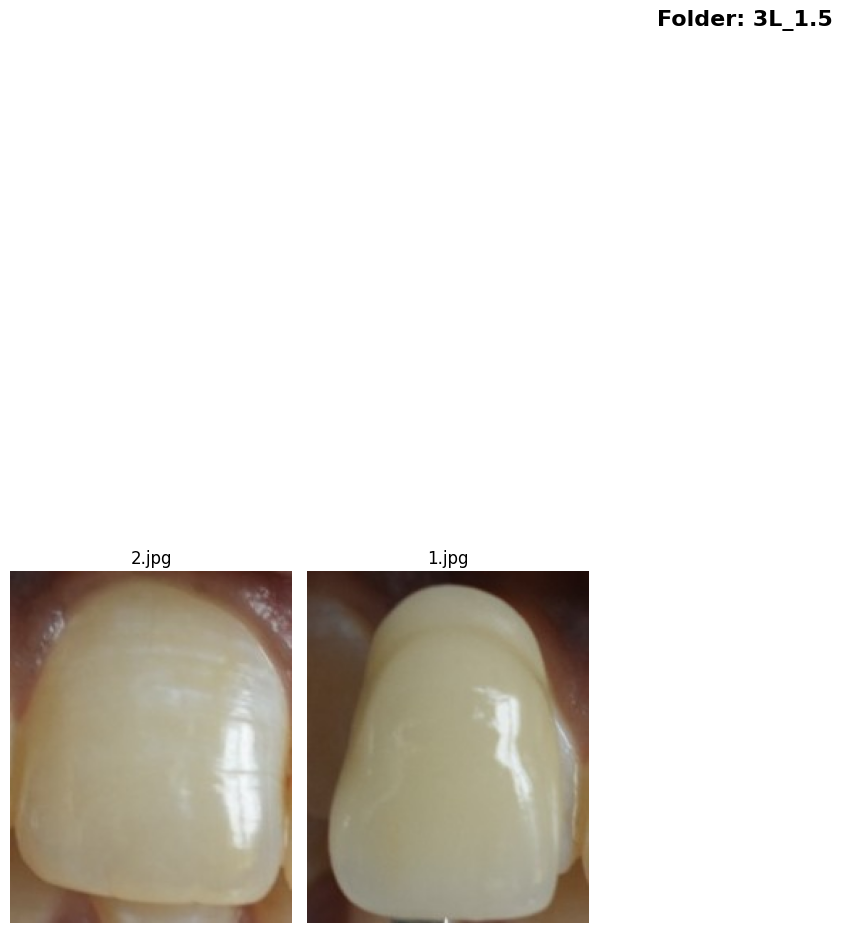

Displaying images from folder: 2R_2.5


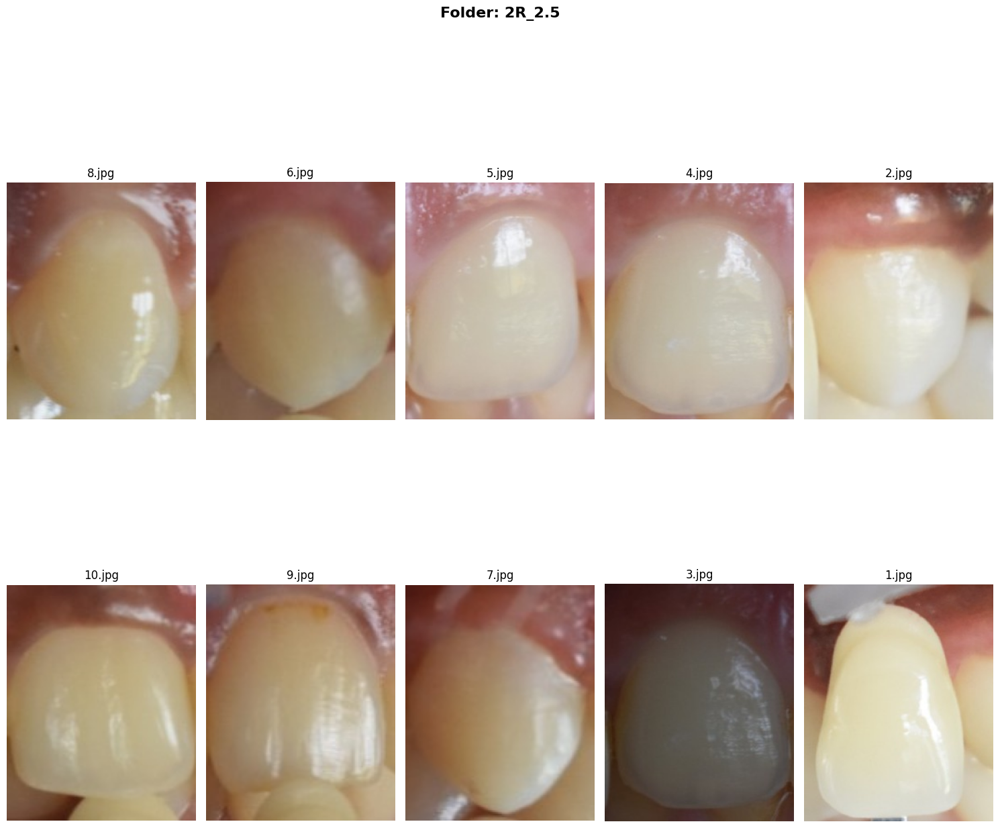

Displaying images from folder: 3M_2


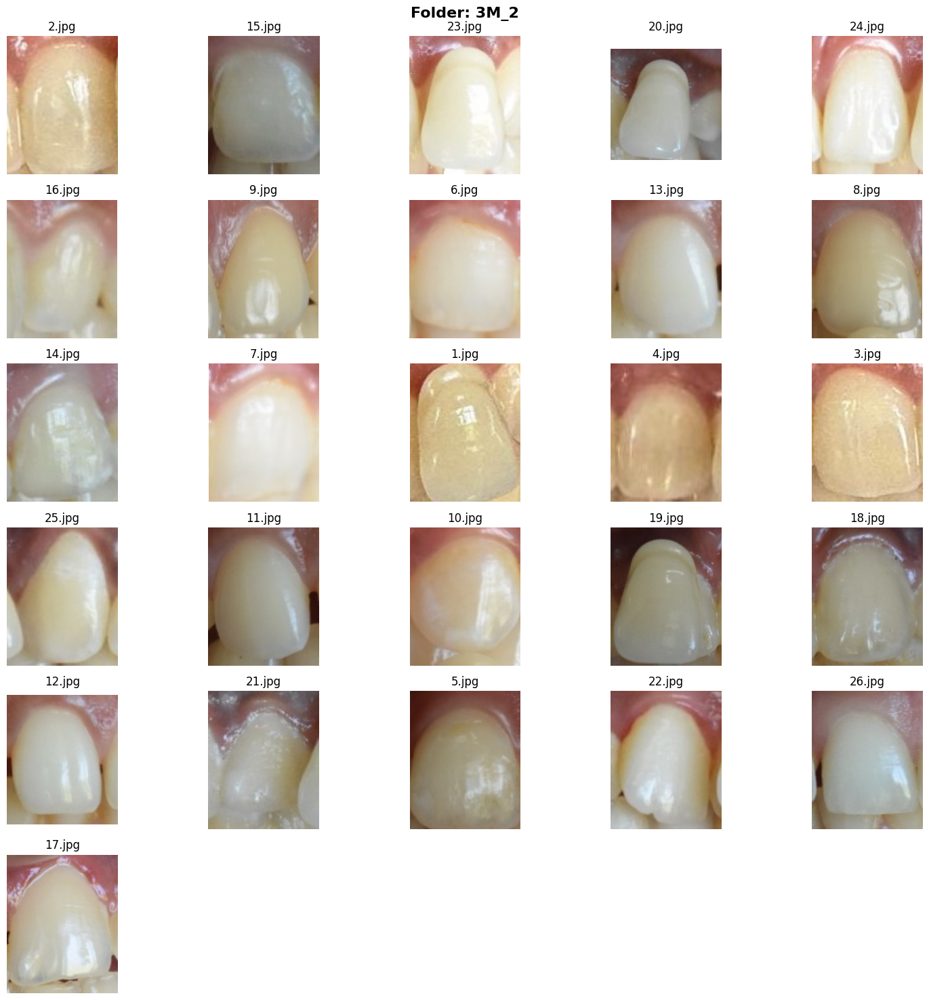

Displaying images from folder: 1M_2


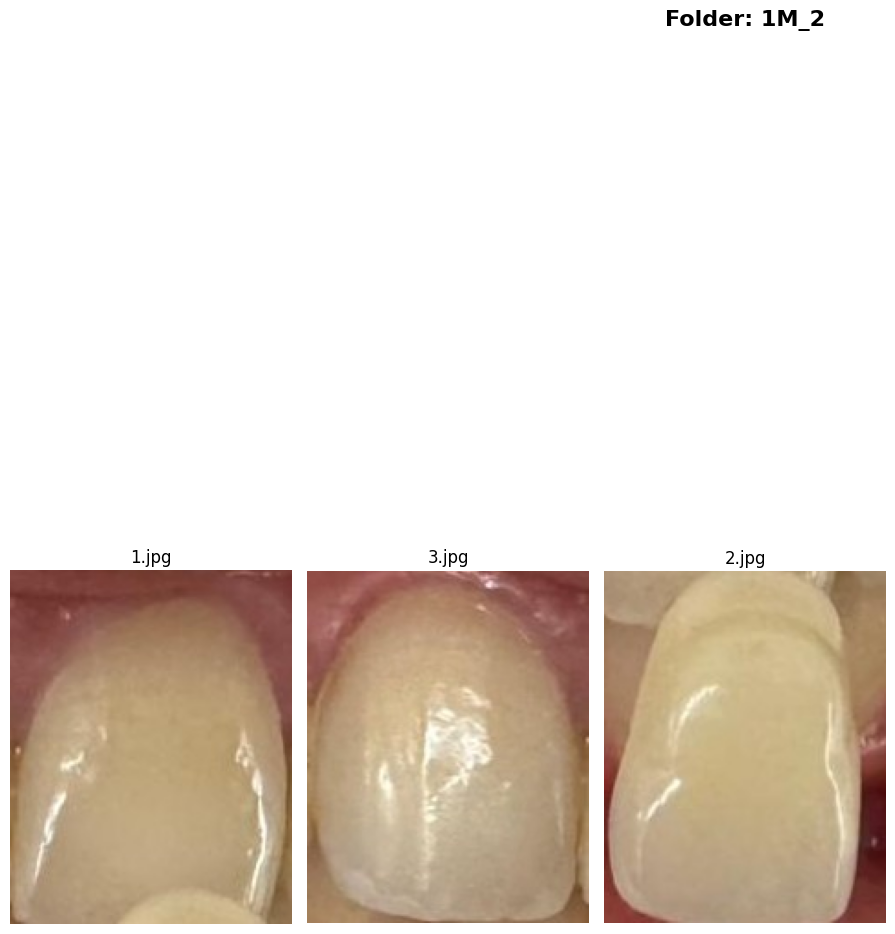

Displaying images from folder: 3M_1


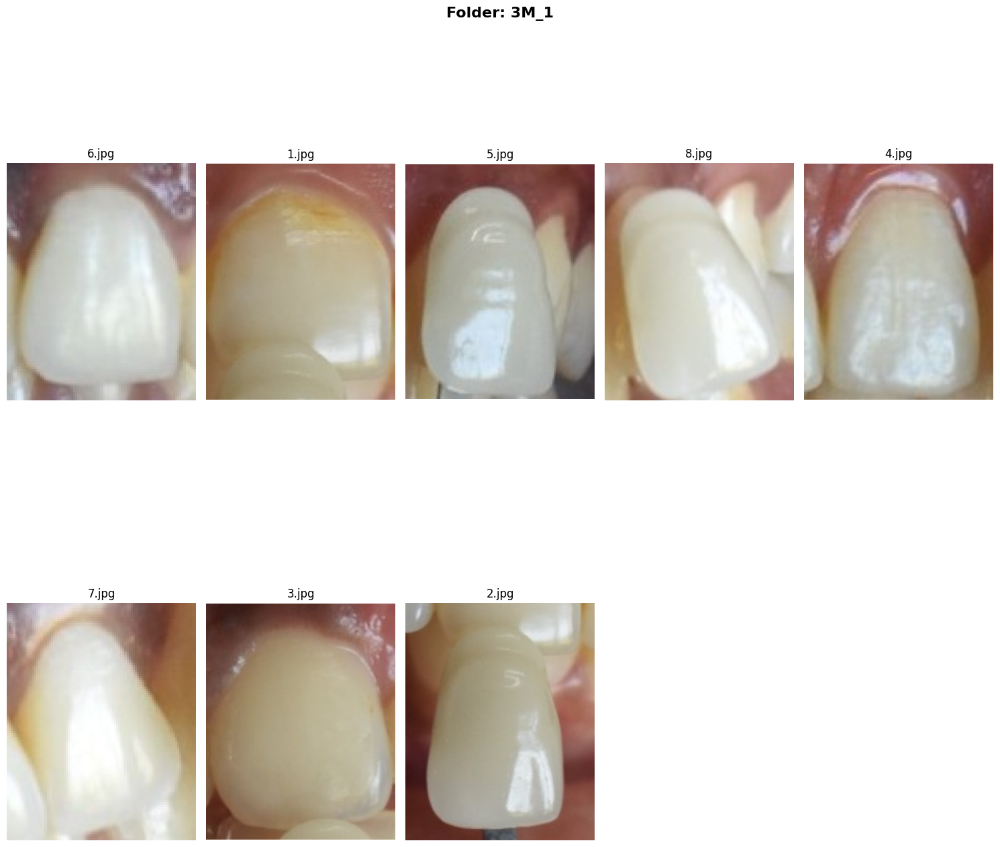

Displaying images from folder: 4M_1


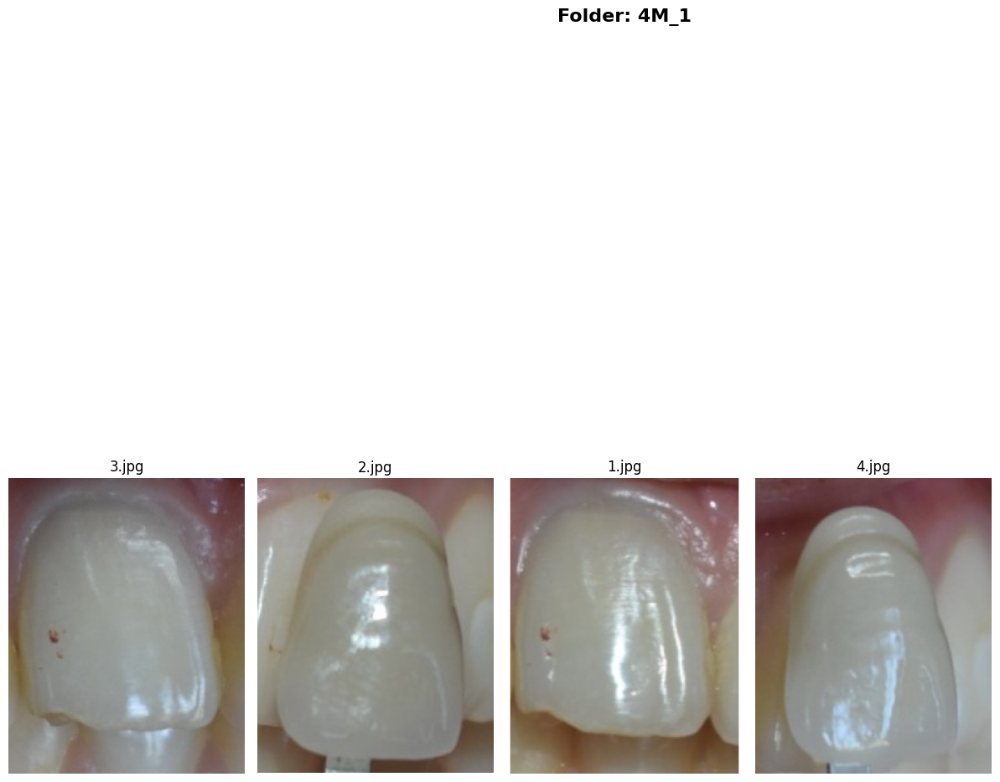

Displaying images from folder: 4M_3


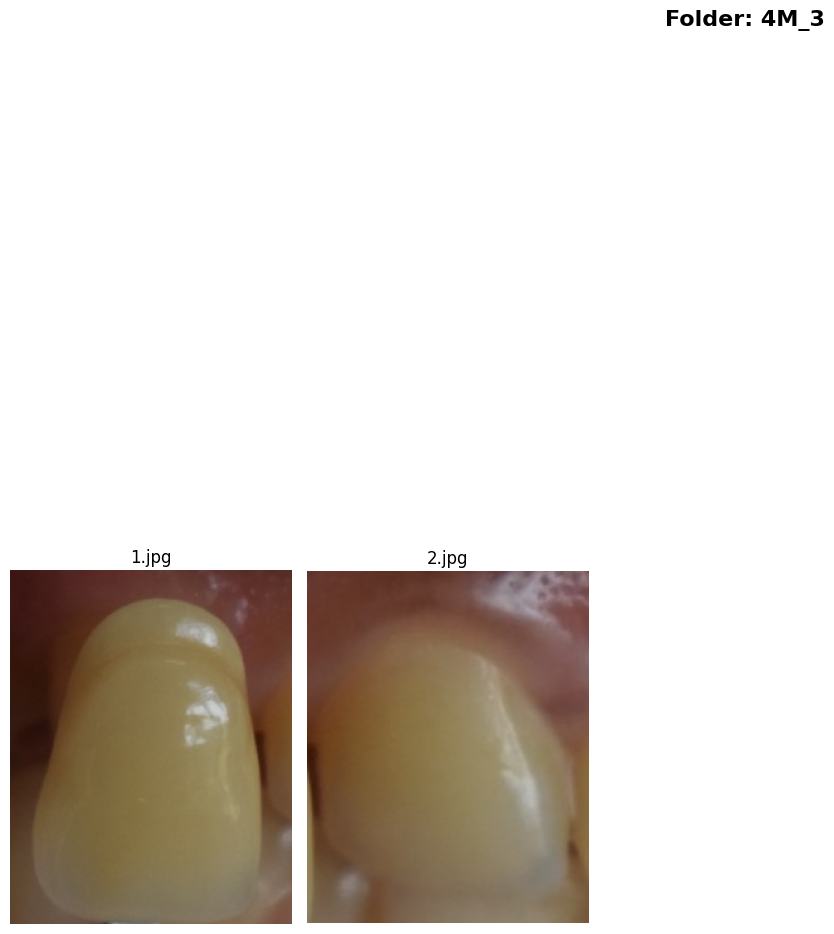

Displaying images from folder: 2L_2.5


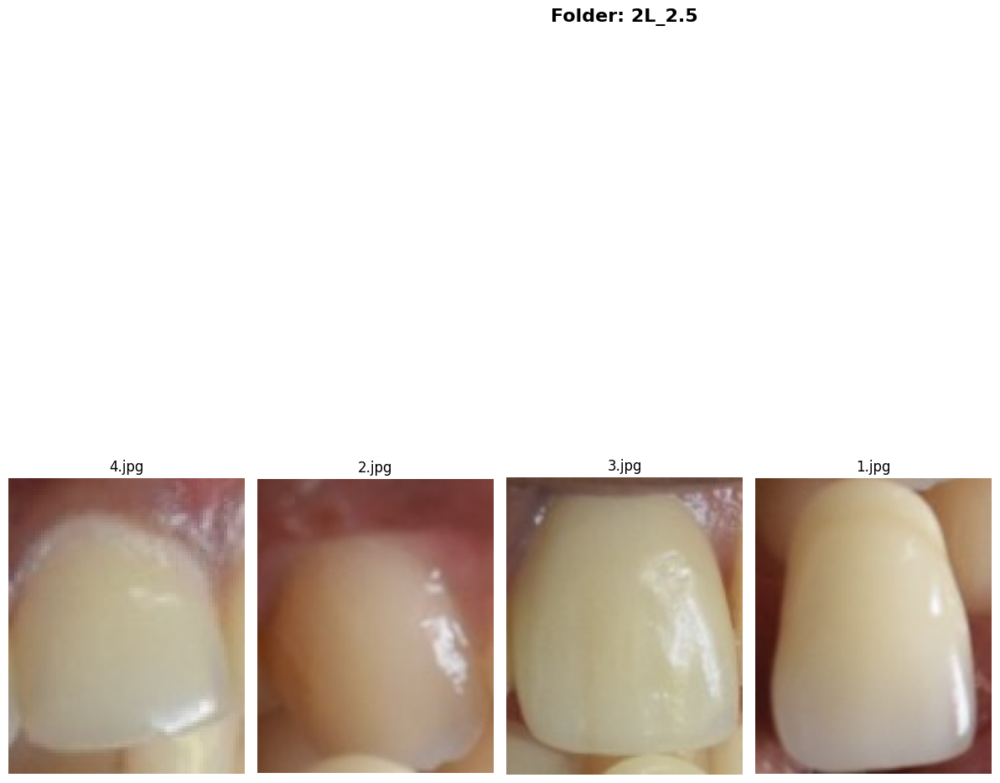

Displaying images from folder: 2M_1


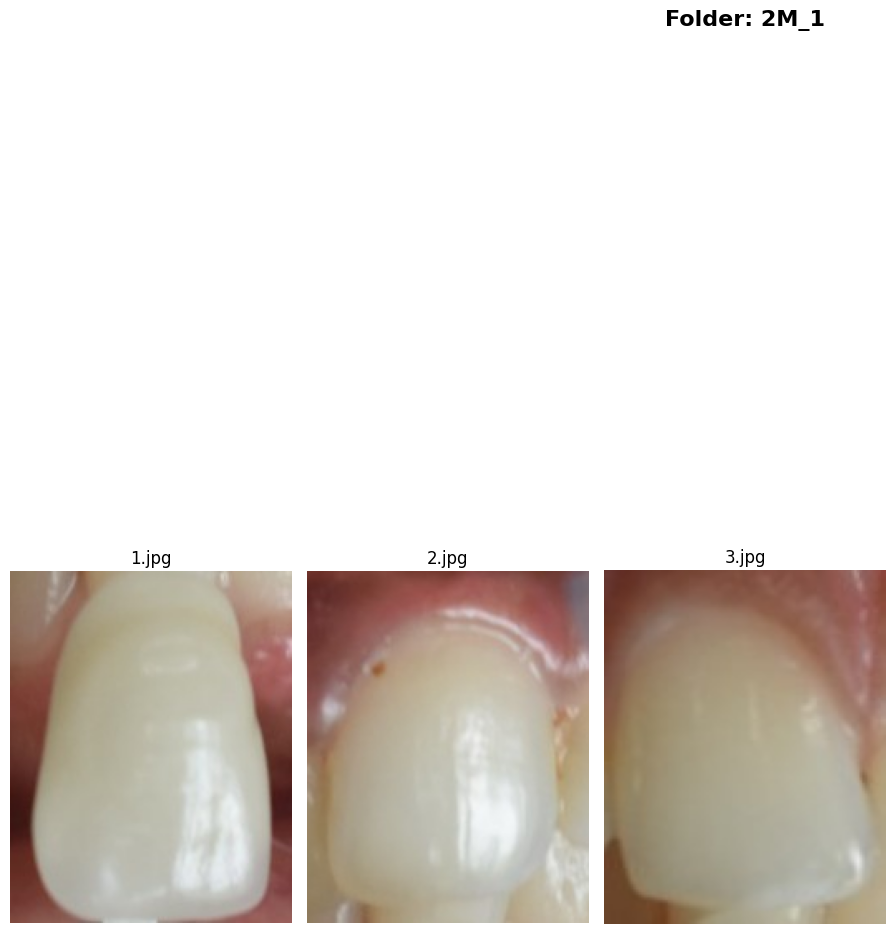

Displaying images from folder: 4L_2.5


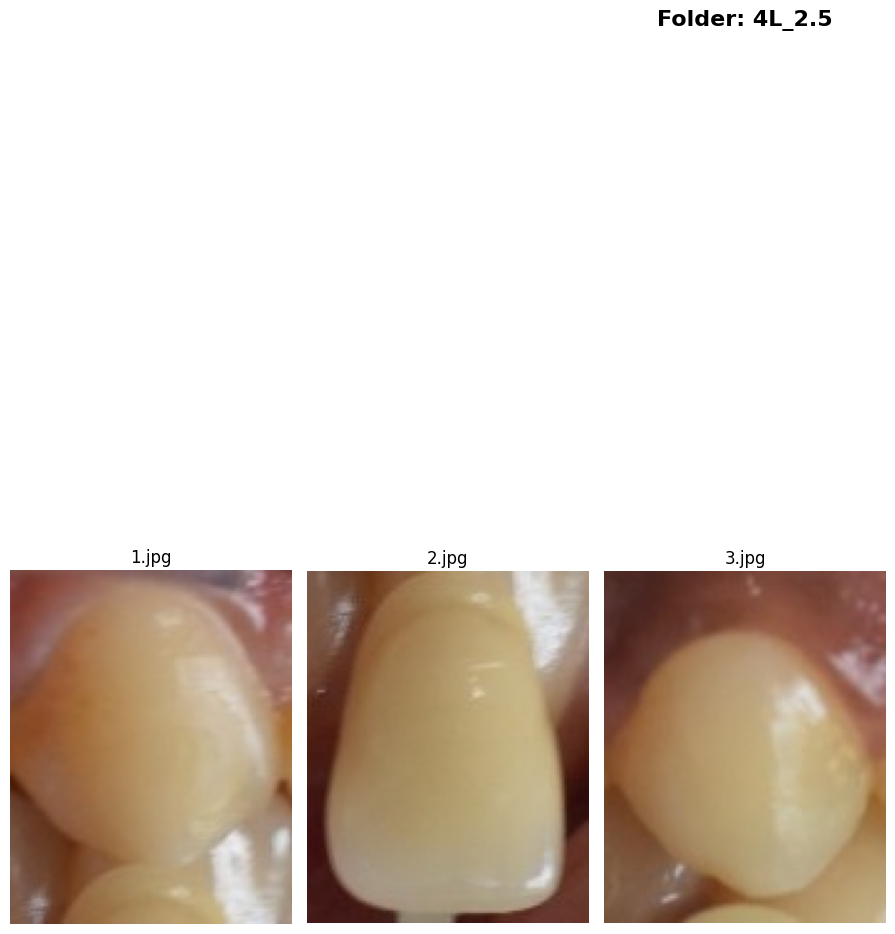

Displaying images from folder: 2L_1.5


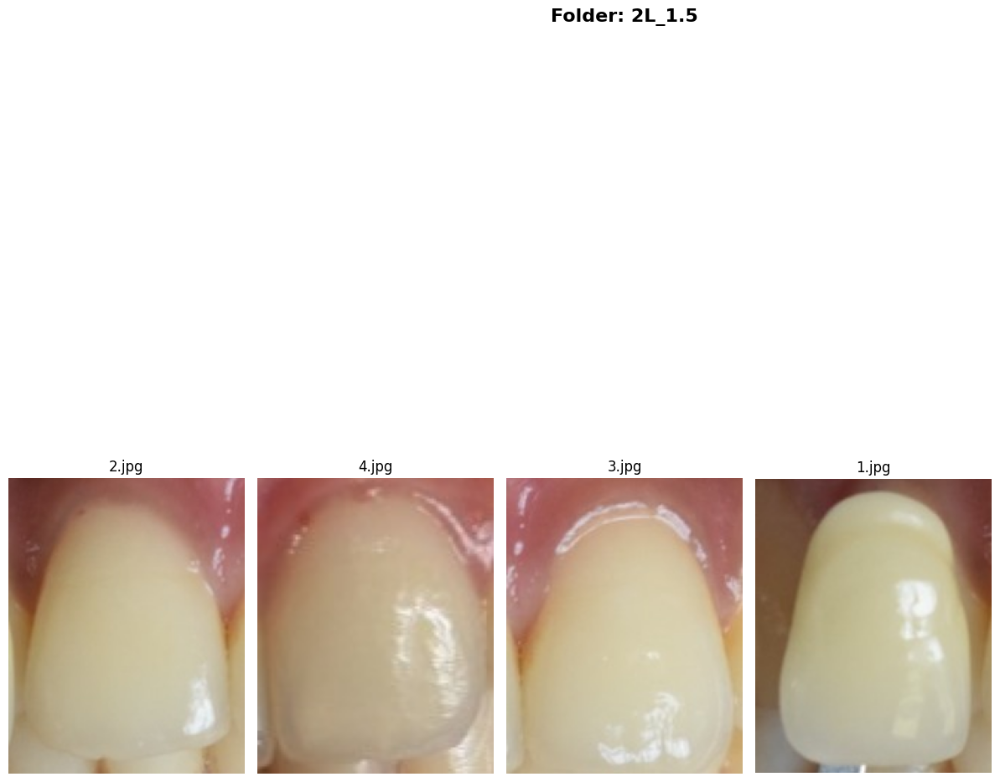

Displaying images from folder: 2R_1.5


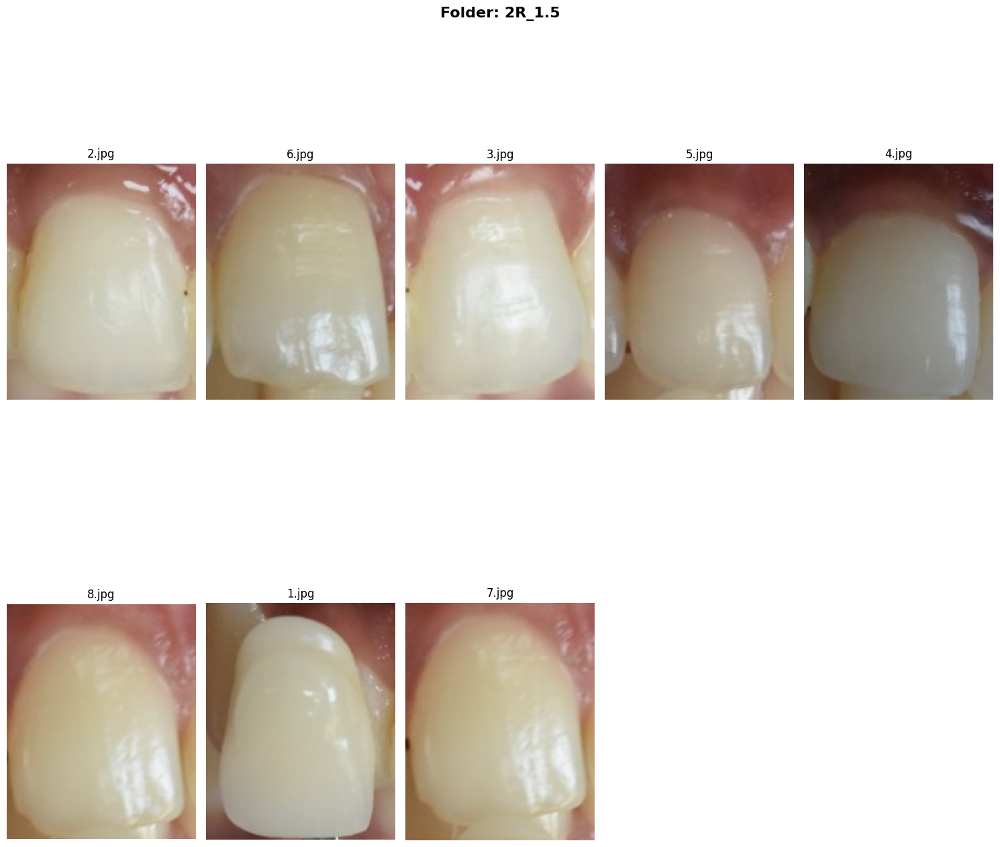

Displaying images from folder: 3M_3


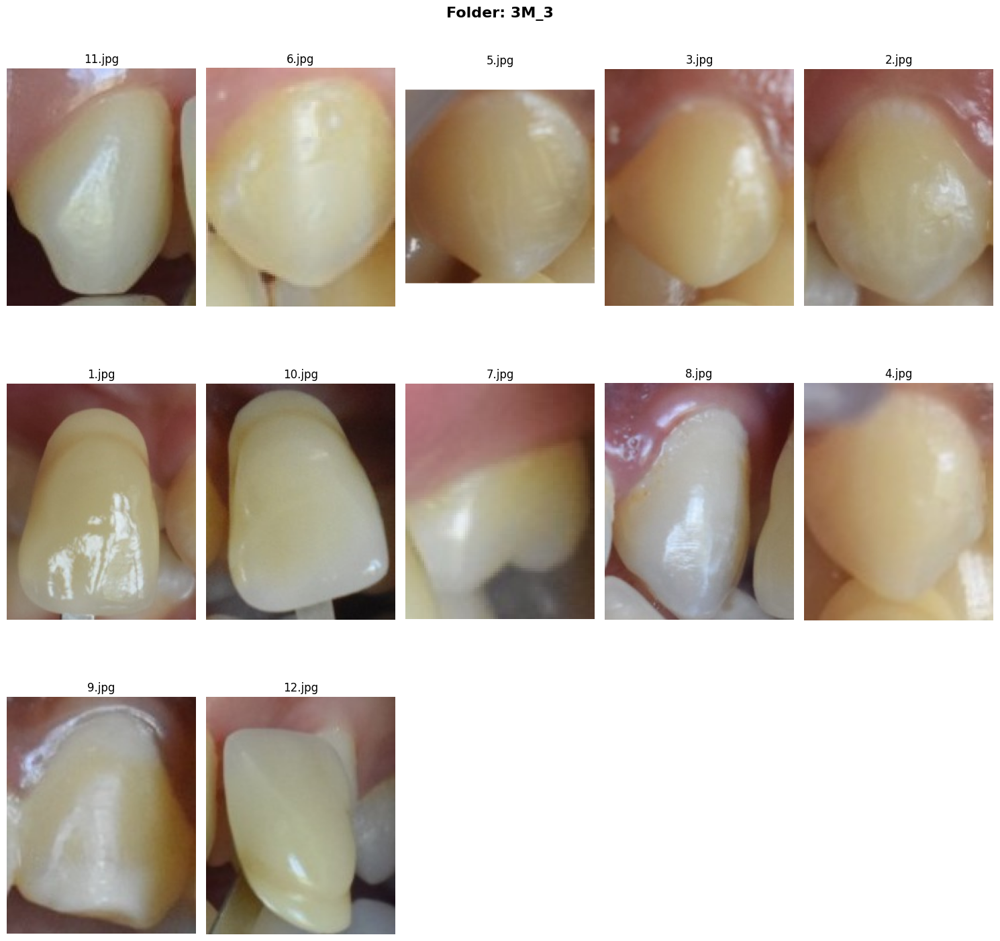

In [28]:
import numpy as np

TARGET_RATIO = (4, 5)  # 4:5 aspect ratio

# Function to resize while maintaining aspect ratio
def ensure_aspect_ratio(image, target_ratio=(4, 5), padding_color=(255, 255, 255)):
    """
    Adjusts the image to match the target aspect ratio by adding padding (not cropping).

    Args:
        image: The input image (NumPy array).
        target_ratio: Desired aspect ratio as (width, height).
        padding_color: Background color for padding (default: white).

    Returns:
        Resized image with the correct aspect ratio.
    """
    height, width = image.shape[:2]
    target_width, target_height = target_ratio

    # Calculate current aspect ratio
    current_ratio = width / height
    desired_ratio = target_width / target_height

    if abs(current_ratio - desired_ratio) < 0.01:  # If already close to 4:5, return as is
        return image

    # Calculate new size
    if current_ratio > desired_ratio:
        new_width = width
        new_height = int(width * (target_height / target_width))
    else:
        new_height = height
        new_width = int(height * (target_width / target_height))

    # Create a blank image with the new size
    padded_image = np.full((new_height, new_width, 3), padding_color, dtype=np.uint8)

    # Compute centering offset
    x_offset = (new_width - width) // 2
    y_offset = (new_height - height) // 2

    # Place the original image at the center of the new image
    padded_image[y_offset:y_offset+height, x_offset:x_offset+width] = image

    return padded_image

# Check if the main folder exists
if not os.path.exists(folder_path):
    print(f"Error: The folder '{folder_path}' does not exist. Check the path.")
else:
    # List all subfolders inside the main folder
    subfolders = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, f))]

    # Check if subfolders exist
    if not subfolders:
        print("No subfolders found.")
    else:
        for folder in subfolders:
            folder_name = os.path.basename(folder)  # Extract folder name
            print(f"Displaying images from folder: {folder_name}")

            # Get all images in the folder
            image_files = [os.path.join(folder, f) for f in os.listdir(folder) if f.lower().endswith(('png', 'jpg', 'jpeg'))]

            if not image_files:
                print(f"No images found in {folder_name}.")
                continue

            # Set grid size for the folder
            num_images = len(image_files)
            cols = 5  # Number of columns
            rows = (num_images // cols) + (1 if num_images % cols else 0)  # Calculate rows needed

            # Create figure
            fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
            fig.suptitle(f"Folder: {folder_name}", fontsize=16, fontweight="bold")  # Add folder name as title

            # Convert axes to a 2D list if there's only one row
            if rows == 1:
                axes = [axes] if cols > 1 else [[axes]]

            i = 0
            for i, img_path in enumerate(image_files):
                image = cv2.imread(img_path)

                if image is None:
                    print(f"Error loading image: {img_path}")
                    continue

                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
                image = ensure_aspect_ratio(image, TARGET_RATIO)  # Ensure 4:5 aspect ratio

                # Get subplot position safely
                row_idx = i // cols
                col_idx = i % cols

                ax = axes[row_idx][col_idx] if rows > 1 else axes[0][col_idx]  # Ensure indexing is always valid

                ax.imshow(image)
                ax.axis('off')
                ax.set_title(os.path.basename(img_path)[:20])  # Show part of filename

            # Hide empty subplots
            for j in range(i + 1, rows * cols):
                row_idx = j // cols
                col_idx = j % cols
                if rows > 1:
                    fig.delaxes(axes[row_idx][col_idx])
                else:
                    fig.delaxes(axes[0][col_idx])

            plt.tight_layout()
            plt.show()


# ***Light normalization***

In [42]:
import cv2
import numpy as np

# Function to apply CLAHE for local contrast enhancement
def normalize_lighting(image):
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)  # Convert to LAB color space
    l, a, b = cv2.split(lab)

    # Apply CLAHE on the L channel
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l = clahe.apply(l)

    # Merge and convert back to RGB
    lab = cv2.merge((l, a, b))
    return cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)

# Function to apply Gamma Correction
def gamma_correction(image, gamma=1.2):
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
    return cv2.LUT(image, table)



Processing folder: 2M_3


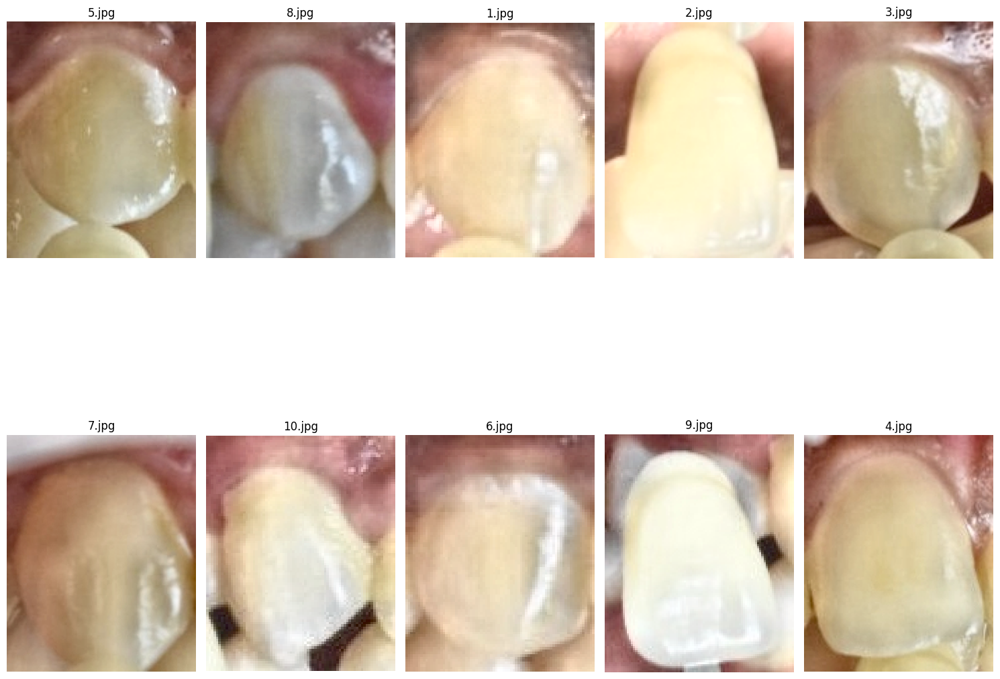

Processing folder: 2M_2


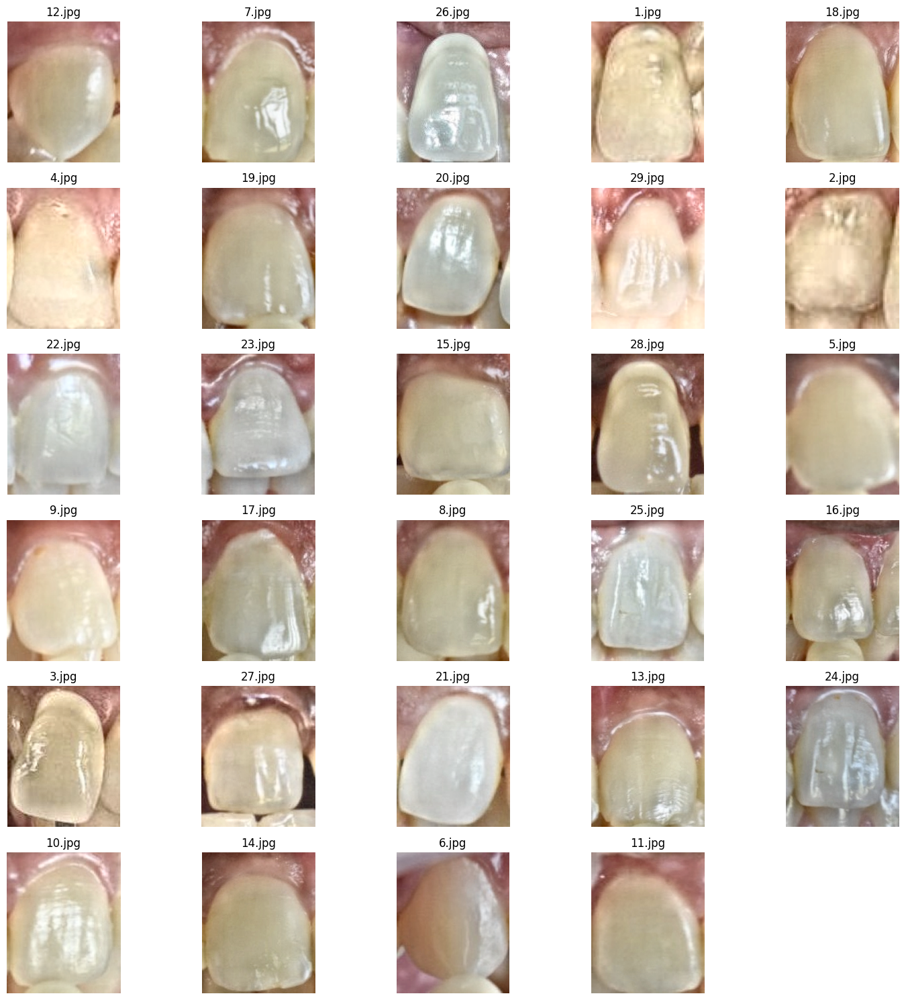

Processing folder: 3R_2.5


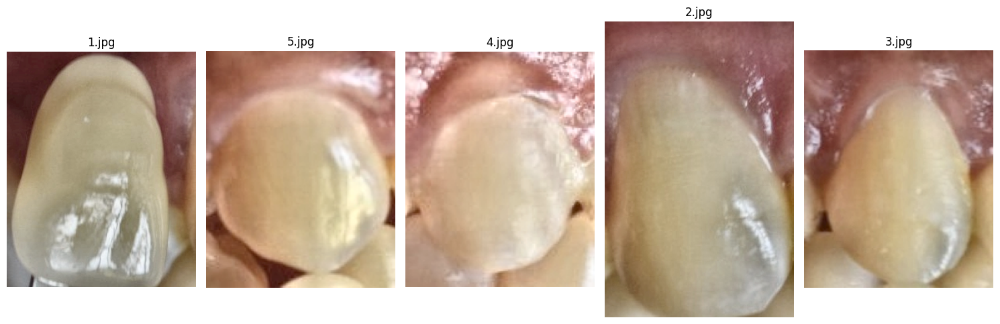

Processing folder: 3L_2.5


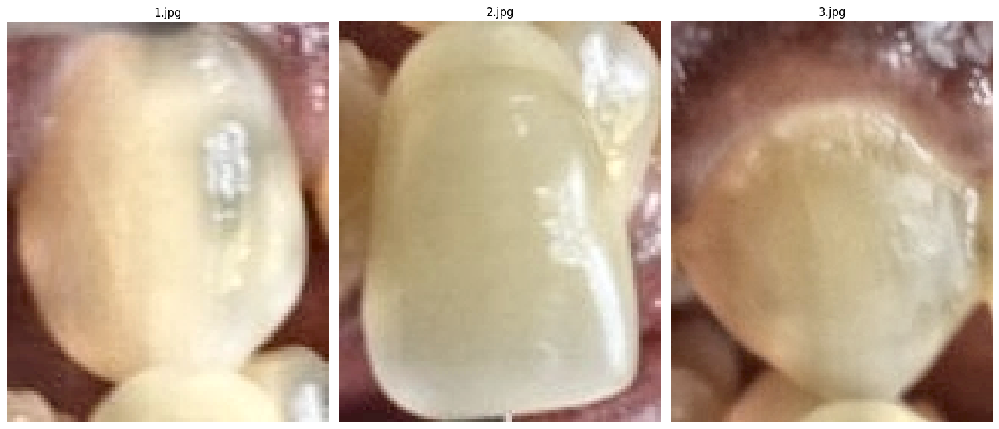

Processing folder: 3L_1.5


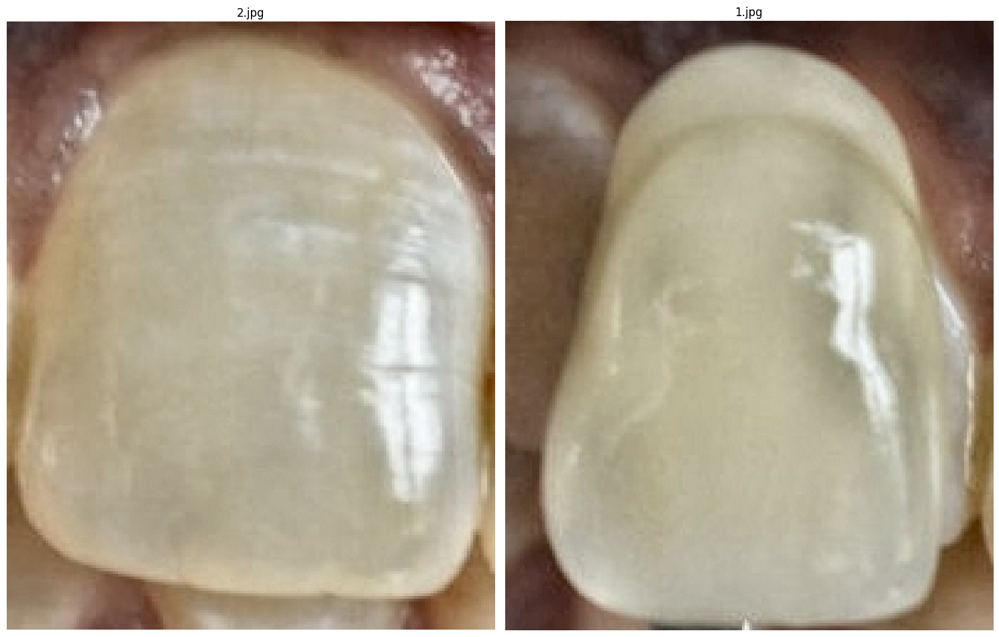

Processing folder: 2R_2.5


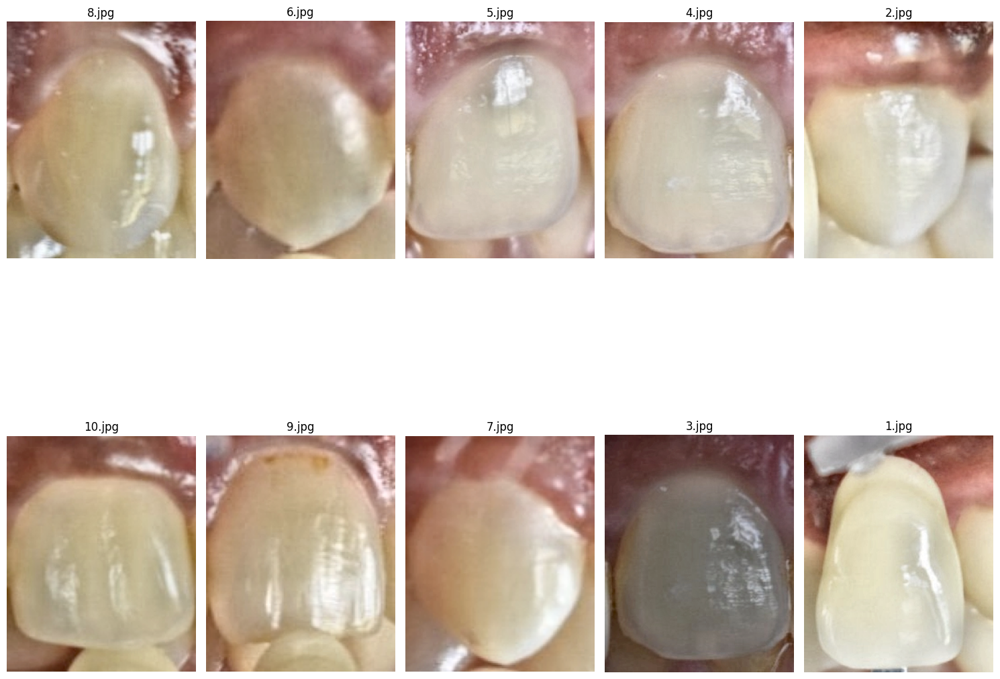

Processing folder: 3M_2


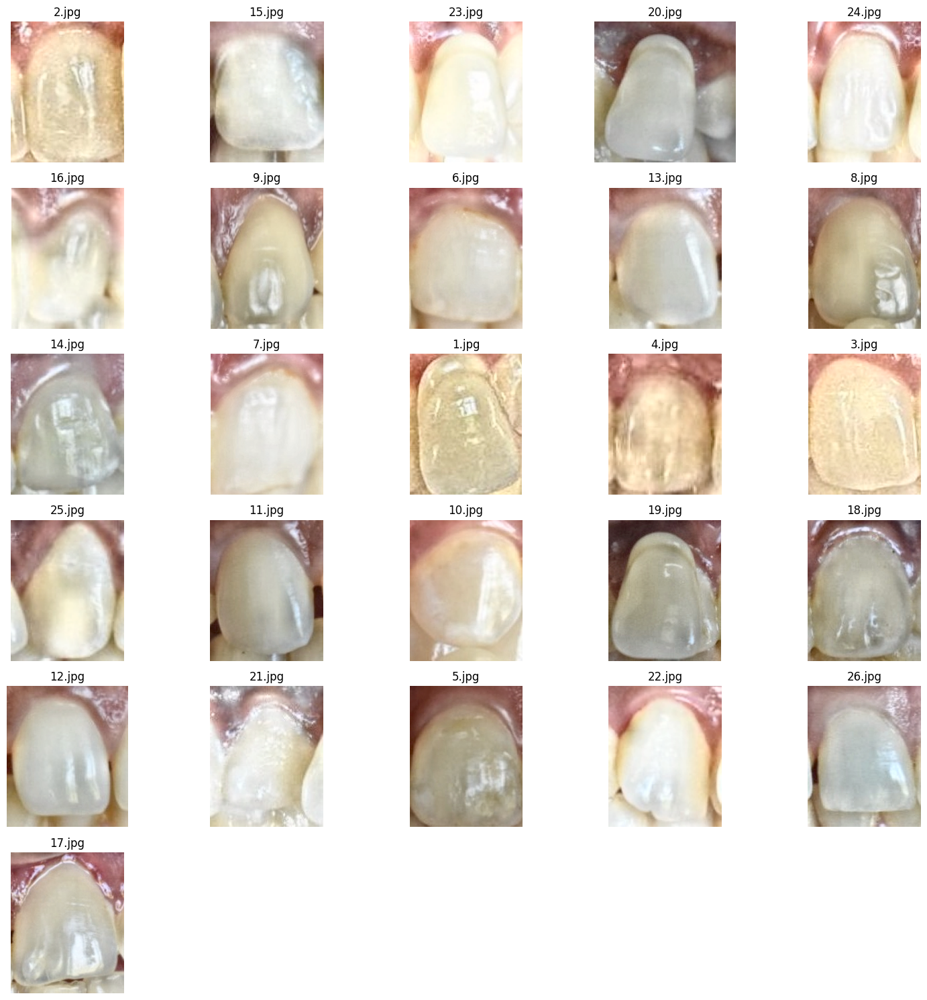

Processing folder: 1M_2


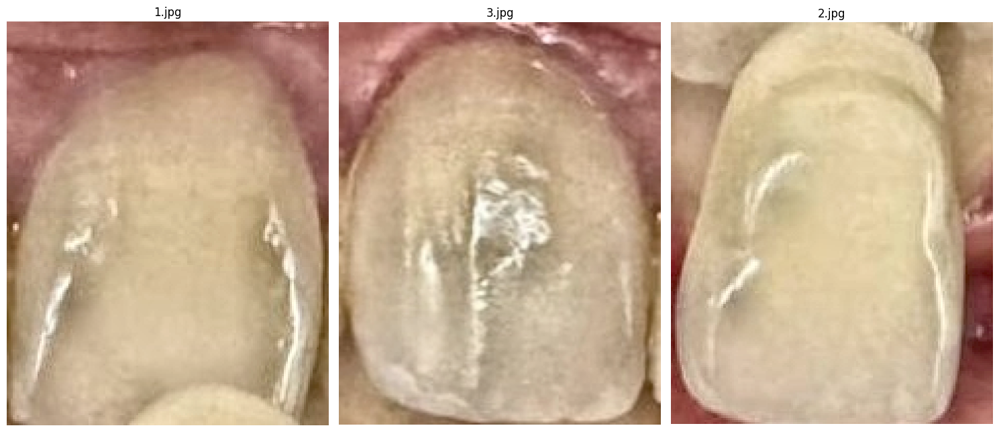

Processing folder: 3M_1


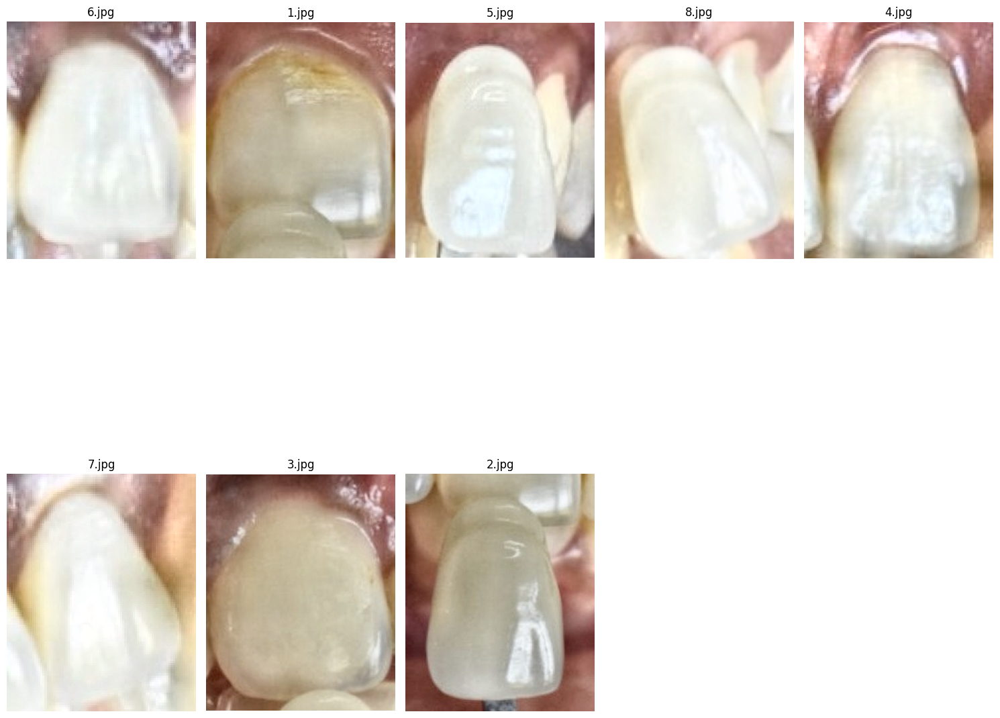

Processing folder: 4M_1


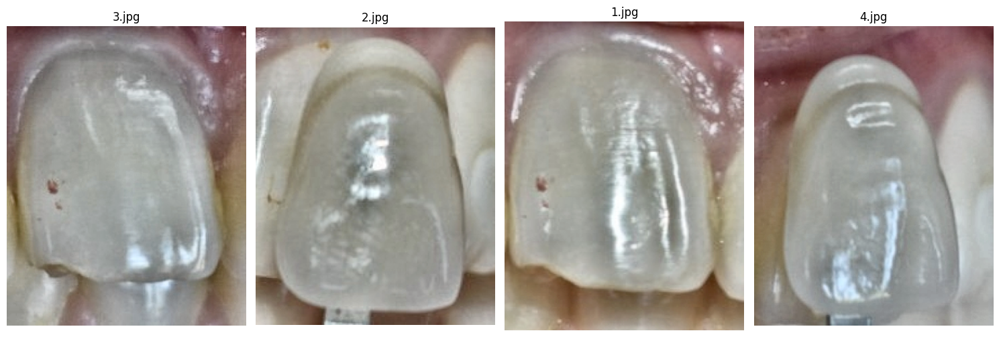

Processing folder: 4M_3


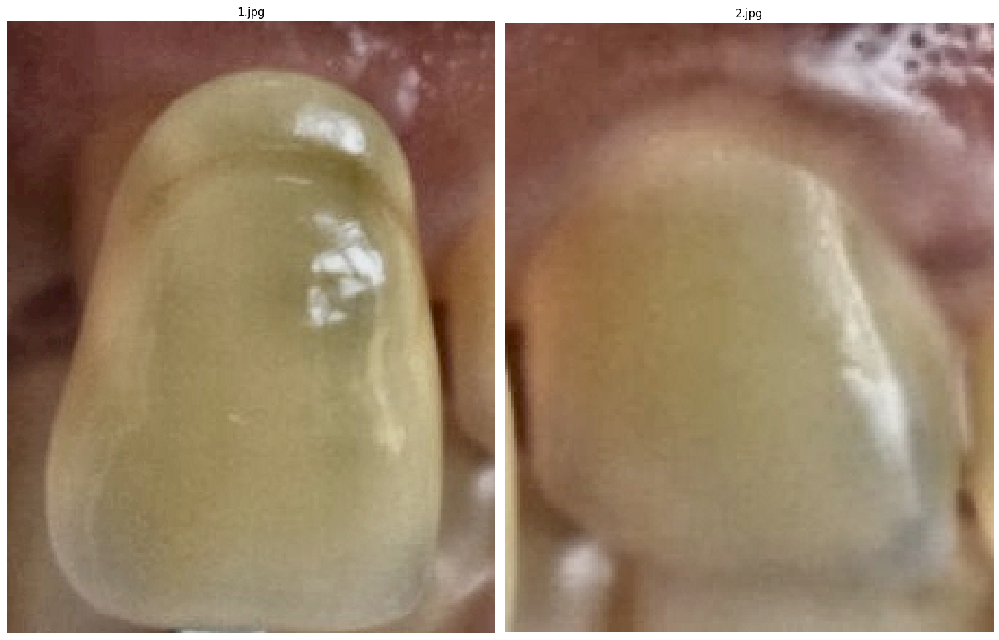

Processing folder: 2L_2.5


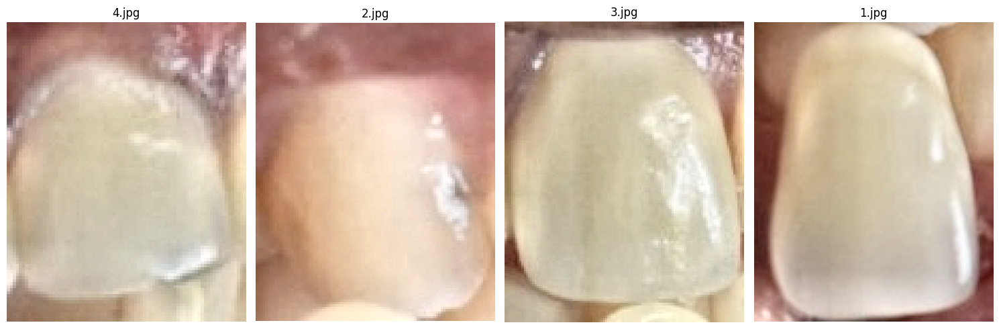

Processing folder: 2M_1


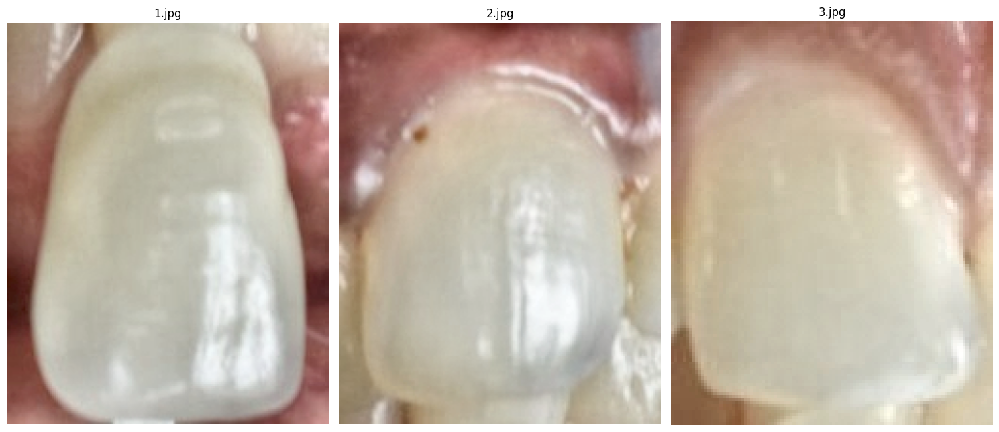

Processing folder: 4L_2.5


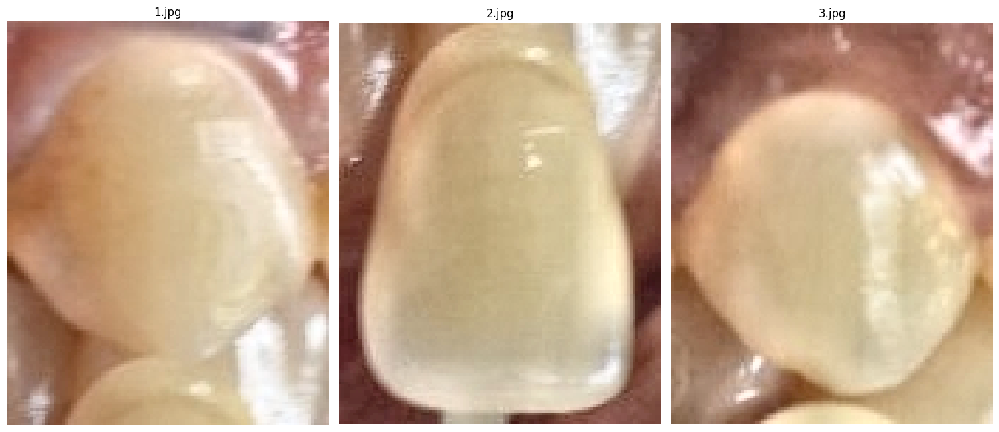

Processing folder: 2L_1.5


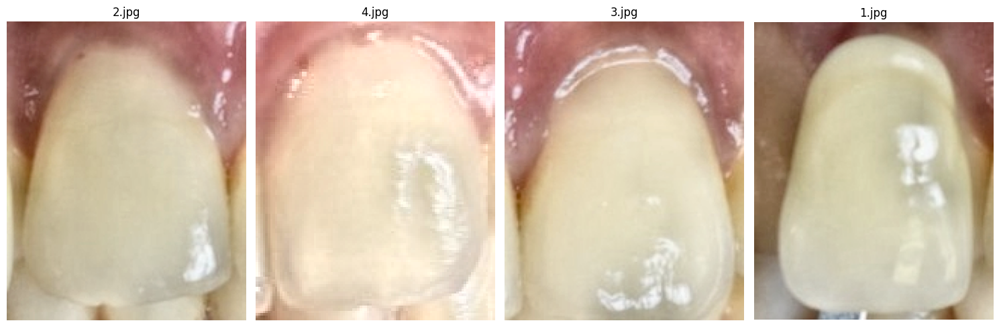

Processing folder: 2R_1.5


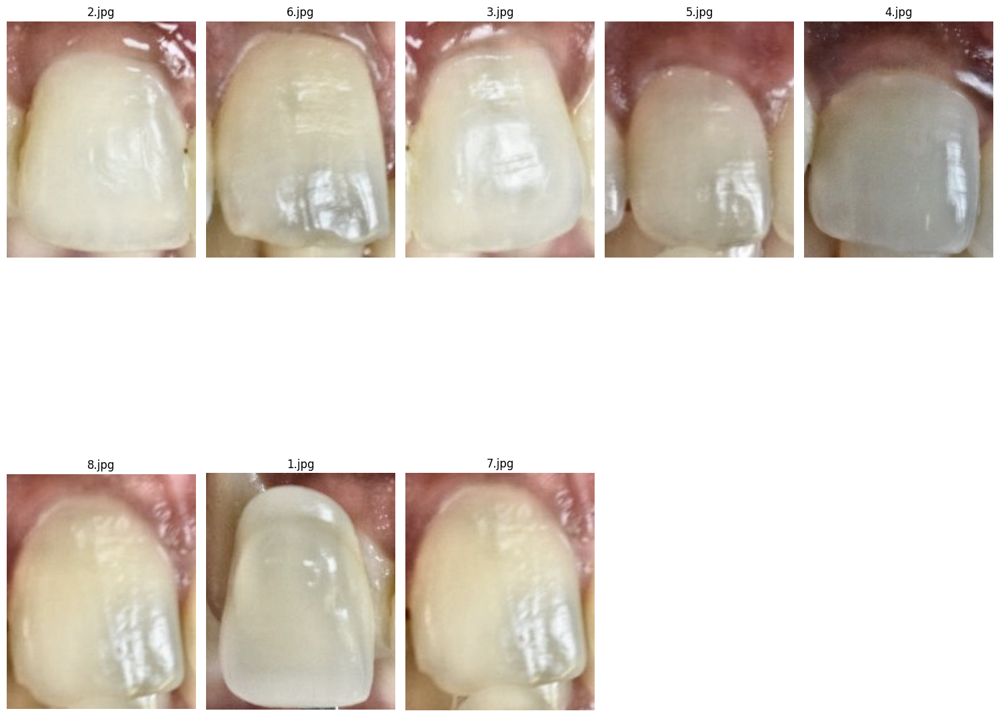

Processing folder: 3M_3


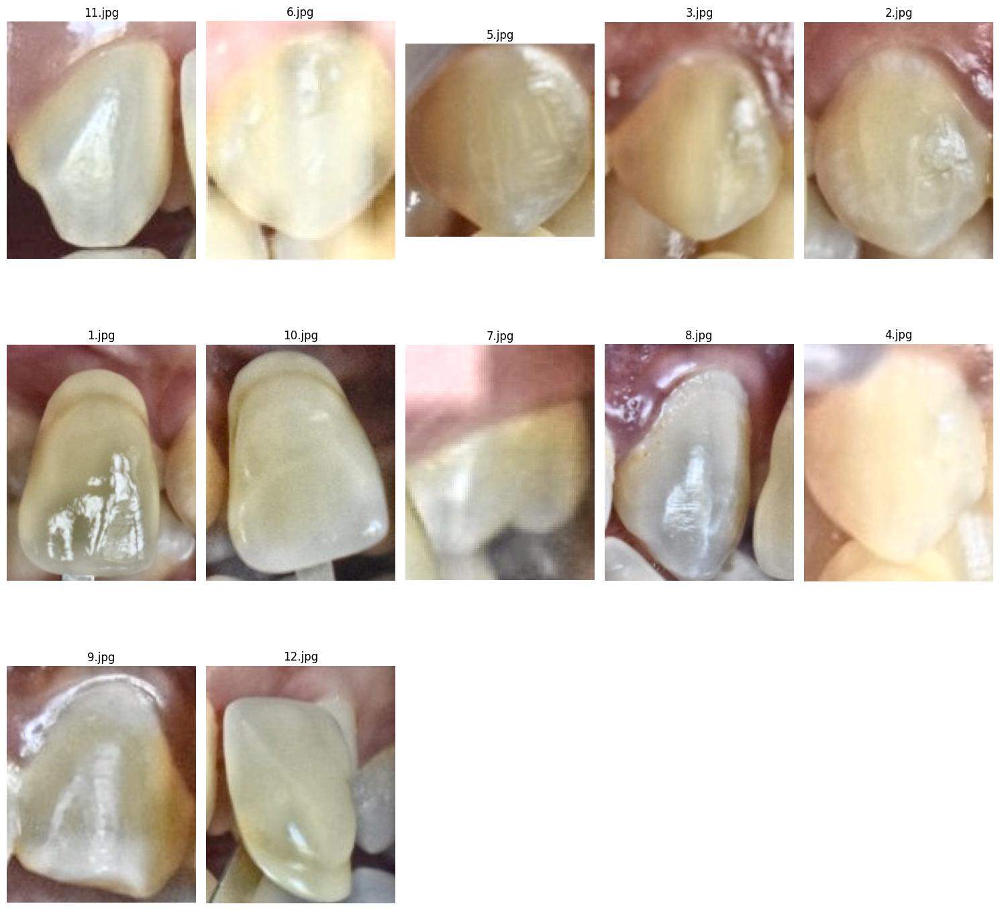

In [43]:
# Function to display light-normalized images from each folder
def display_light_normalized_images(folder_path):
    # Get all subfolders
    subfolders = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, f))]

    for folder in subfolders:
        images = []
        filenames = []

        print(f"Processing folder: {os.path.basename(folder)}")

        for file in os.listdir(folder):
            if file.lower().endswith(('png', 'jpg', 'jpeg')):
                img_path = os.path.join(folder, file)
                image = cv2.imread(img_path)

                if image is None:
                    print(f"Error loading image: {img_path}")
                    continue

                # Convert BGR to RGB
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                # Apply lighting normalization (CLAHE + Gamma Correction)
                image = normalize_lighting(image)
                image = gamma_correction(image, gamma=1.2)

                images.append(image)
                filenames.append(file)

        if images:
            # Display images in a grid
            num_images = len(images)
            cols = min(5, num_images)  # Max 5 columns
            rows = (num_images // cols) + (1 if num_images % cols else 0)

            fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
            axes = axes.flatten()

            for i, (img, fname) in enumerate(zip(images, filenames)):
                ax = axes[i]
                ax.imshow(img)
                ax.axis('off')
                ax.set_title(fname[:15])  # Show filename

            # Hide empty subplots
            for j in range(i + 1, len(axes)):
                fig.delaxes(axes[j])

            plt.tight_layout()
            plt.show()
        else:
            print(f"No images found in {folder}")

# Example usage
folder_path = "/content/drive/My Drive/Dataset"  # Change this to your folder path
display_light_normalized_images(folder_path)
